In [1]:
from src.LatentSpace import LatentSpace
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
import pandas as pd
import umap
import tqdm as notebook_tqdm
from sklearn.cluster import KMeans
import seaborn as sns
import umap.plot
from sklearn.cluster import MiniBatchKMeans

In [2]:
latent_space = LatentSpace(autoencoder_path='data/autoencoder_256dim_time_freq_128k_20epochs/',
                        image_dir='data/Spotify/comp_pngs/',
                        tracks_feather_path='data/all_tracks.feather',
                        latent_dims=256
                        )

Found 278581 files for Generator set


In [3]:
latent_space.load('data/autoencoder_256dim_time_freq_128k_20epochs/')

Loaded tracks.
Loaded artists.
Loaded genres.


In [4]:
data = latent_space.tracks[latent_space.latent_cols]

In [5]:
data

,latent_0,latent_1,latent_2,latent_3,latent_4,latent_5,latent_6,latent_7,latent_8,latent_9,...,latent_246,latent_247,latent_248,latent_249,latent_250,latent_251,latent_252,latent_253,latent_254,latent_255
0,-0.931660,-0.626811,0.090862,-0.487362,-0.231261,0.657932,0.481978,0.235842,1.229176,1.267860,...,0.321960,-0.001884,0.574424,-1.004930,0.594318,0.404193,-1.745245,1.742032,0.534379,-0.241360
1,1.209017,1.277720,0.524220,0.346246,-0.072498,0.521157,0.400701,-0.652425,-1.005345,0.170095,...,0.865386,-1.125806,-1.332991,0.554633,1.250077,-1.118001,-0.865248,0.189626,-0.004492,-0.737362
2,0.449398,0.413738,1.595486,2.069899,0.434889,-0.969680,1.194437,1.308343,-0.406599,-0.768051,...,0.357984,-0.819527,-0.159966,0.582954,1.332349,-0.302720,-0.447074,0.898518,1.224243,-0.493022
3,1.083664,1.591620,0.315347,-0.435670,-0.579585,-0.375655,0.586821,-1.628904,-1.411103,0.419329,...,0.418166,-0.644525,-0.972410,-0.356374,0.288352,-0.932634,0.875872,-0.952486,-0.854201,-1.272085
4,0.603089,0.680073,0.226260,-0.020473,-1.035093,-0.119424,-0.509234,-0.172511,-0.442947,0.686625,...,0.749177,-0.771186,-0.858696,0.282798,0.423466,0.329525,0.084555,0.513033,-0.357208,-0.937991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278576,-0.141529,-0.226642,-0.773938,0.120317,-0.537159,0.532362,-0.043472,-0.133557,0.335945,0.776200,...,0.475225,-0.449325,-0.036012,0.396958,0.365573,-0.143605,-1.275701,1.098597,1.008056,-0.139472
278577,1.332621,0.996855,1.248878,0.434891,1.367930,-0.036469,0.693274,1.832018,-1.955028,-1.698375,...,0.692193,-0.827826,-0.803944,0.508085,0.858553,-1.556203,-0.135382,-0.380890,0.264611,-0.985796
278578,-0.594773,-0.708595,0.668848,-1.107825,0.064474,1.859434,-0.144631,0.289637,1.512217,0.327976,...,-0.102665,0.597476,-0.208622,-1.243085,-0.910240,1.326845,-0.560565,-0.615501,-1.561976,0.588529
278579,0.193448,-0.079071,0.926702,0.323592,0.302587,-0.630976,-0.018649,0.095105,-0.073371,0.981023,...,-0.116639,0.015779,0.179222,-1.179214,0.165581,-0.728083,0.129916,-0.484665,0.947530,0.311358


In [6]:
embedding = umap.UMAP(n_neighbors=50, min_dist=.1).fit_transform(data)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


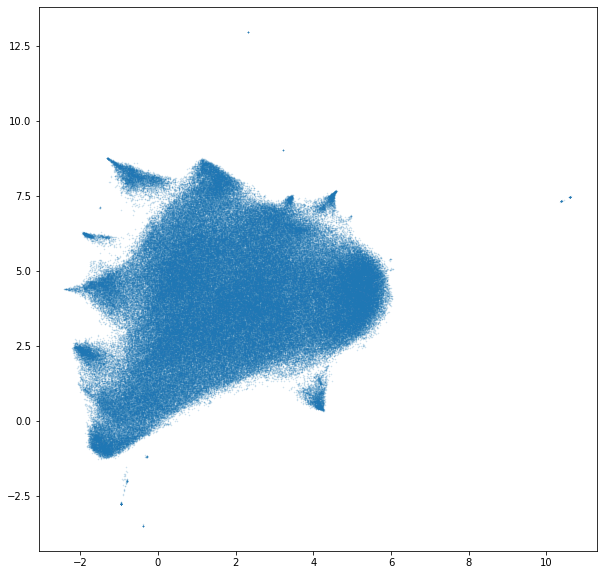

In [7]:
fig, ax = plt.subplots(1, figsize=(10, 10))
plt.scatter(*embedding.T, s=0.3, alpha=.2)

/Users/michaelroth/miniforge3/envs/golden_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


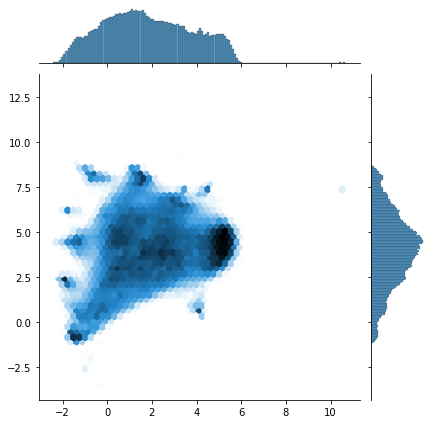

In [8]:
sns.jointplot(*embedding.T, kind='hex')

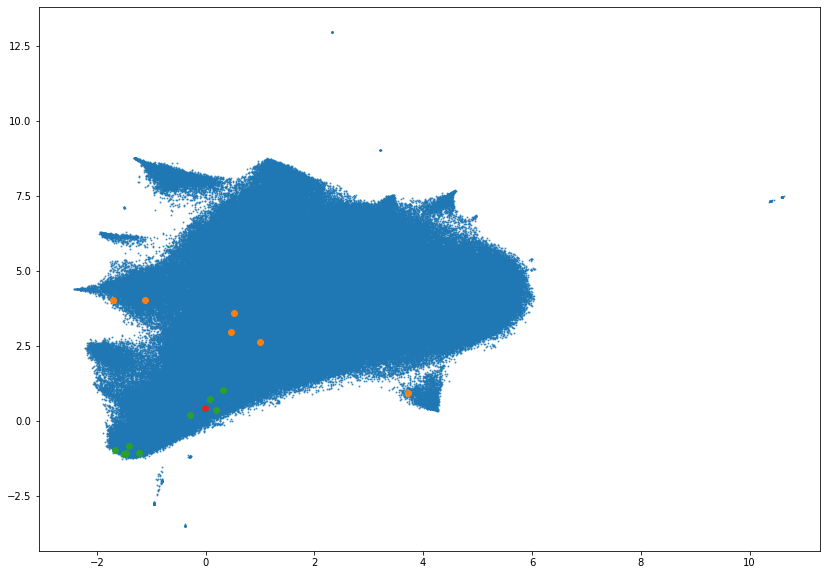

In [9]:
fig, ax = plt.subplots(1, figsize=(14, 10))
plt.scatter(*embedding.T, s=1, alpha=.7)
plt.scatter(*embedding[latent_space.get_index_by_artist_name('Kraftwerk').index].T)
plt.scatter(*embedding[latent_space.get_similar_tracks_by_index(257270, similarity_measure='cosine')['index']].T)
plt.scatter(*embedding[257270].T)
plt.show()

In [10]:
embedding_time = umap.UMAP(n_neighbors=50, min_dist=.1).fit_transform(data[latent_space.latent_cols[:128]])

In [11]:
embedding_freq = umap.UMAP(n_neighbors=50, min_dist=.1).fit_transform(data[latent_space.latent_cols[128:]])

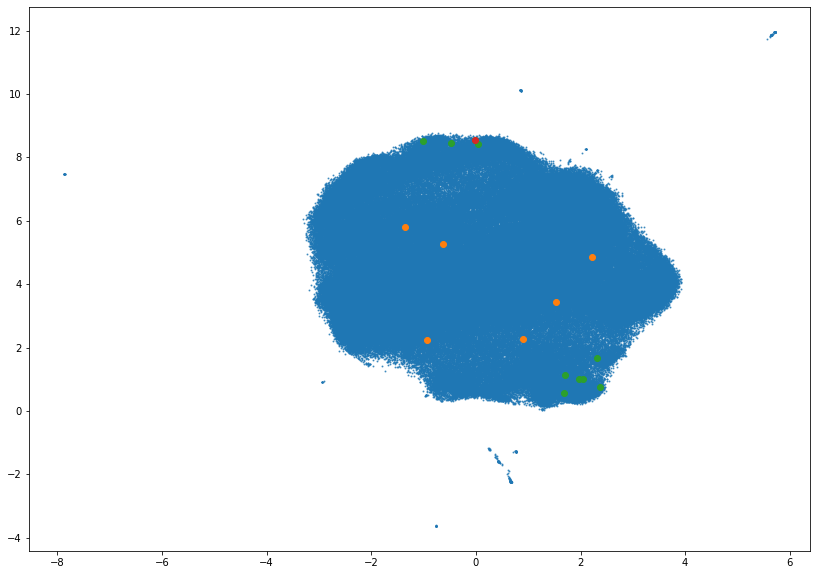

In [12]:
fig, ax = plt.subplots(1, figsize=(14, 10))
plt.scatter(*embedding_time.T, s=1, alpha=.7)
plt.scatter(*embedding_time[latent_space.get_index_by_artist_name('Kraftwerk').index].T)
plt.scatter(*embedding_time[latent_space.get_similar_tracks_by_index(257270, similarity_measure='cosine')['index']].T)
plt.scatter(*embedding_time[257270].T)
plt.show()

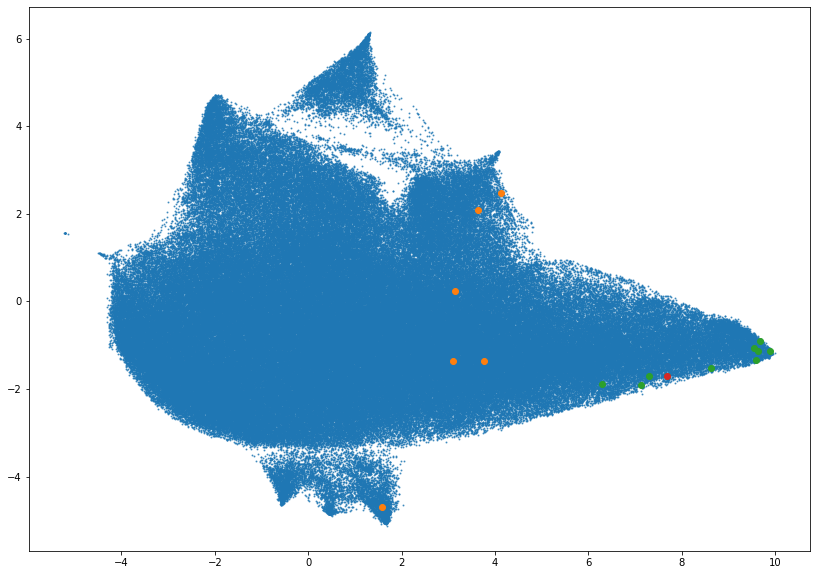

In [13]:
fig, ax = plt.subplots(1, figsize=(14, 10))
plt.scatter(*embedding_freq.T, s=1, alpha=.7)
plt.scatter(*embedding_freq[latent_space.get_index_by_artist_name('Kraftwerk').index].T)
plt.scatter(*embedding_freq[latent_space.get_similar_tracks_by_index(257270)['index']].T)
plt.scatter(*embedding_freq[257270].T)
plt.show()

In [14]:
latent_space.get_index_by_artist_name('Kraftwerk')

,track_id,track_name,artist_name
133220,48Q7pVDuBivnR5rdf6RGYT,Spacelab - 2009 Remaster,Kraftwerk
139696,7CZdd0S4WTktuiiARS8pY4,Computer Love - 2009 Remaster,Kraftwerk
209416,5eqZWYQ5tbIehx00NeKXz7,The Robots - 2009 Remaster,Kraftwerk
211814,6bDRVbdZEyBnmOX0Yjh5rf,Pocket Calculator - 2009 Remaster,Kraftwerk
218191,31uidLEHAcF8Cw1cX1VCS8,Autobahn - 2009 Remaster,Kraftwerk
224855,3VwLD5o1r0YBLkjUfgSEYg,Das Model,Kraftwerk


In [15]:
latent_space.get_similar_tracks_by_index(257270, similarity_measure='cosine')

,index,track_name,artist_name,track_uri,similarity
0,257270,Medication (Merriweather Bradley),Sonny Smith,spotify:track:6Twum7gr6q90jnYYkSnzjW,1.000000
1,53812,Star Shepherd,Corciolli,spotify:track:47BFvqd7NVviRxLuDQwHvX,0.827696
2,49872,Lost in Thought,GoGo Penguin,spotify:track:1UVjC46kICqTceu7wCi8zK,0.826299
3,239869,Nightmares on Repeat,Emily Jane White,spotify:track:5j86pOXbQwoJUmTJj3xiUc,0.822891
4,33024,Hoyt's Office,Hildur Guðnadóttir,spotify:track:1UdiJ6Y2eisfQQ76MZOX4B,0.820565
5,120986,Hurtstone,Simon Bainton,spotify:track:43U7wL4npOtVTb2xmX3uiM,0.818957
6,15561,Purpose,Paul de Jong,spotify:track:1rmsNxRMHmBHzxM9NvKnuy,0.818341
7,187876,Ophelia but It's Muffled and Slowed,Dybbukk,spotify:track:45mK0WT6B7nBOEcc9j3Zj0,0.817917
8,80683,Daughter,Raum,spotify:track:0dF6zuAnxYtr7apDEFKly7,0.816235
9,257171,118,d'Eon,spotify:track:0iyKus8cgS771bxe3YIjrl,0.813702


In [16]:
from sklearn.metrics.pairwise import cosine_similarity

seed_index = 125661

similarities = cosine_similarity([latent_space.tracks.iloc[seed_index][latent_space.latent_cols]], latent_space.tracks[latent_space.latent_cols])

time_similarities = cosine_similarity([latent_space.tracks.iloc[seed_index][latent_space.latent_cols[:128]]], latent_space.tracks[latent_space.latent_cols[:128]])

freq_similarities = cosine_similarity([latent_space.tracks.iloc[seed_index][latent_space.latent_cols[128:]]], latent_space.tracks[latent_space.latent_cols[128:]])

similarities_df = latent_space.tracks.copy()

similarities_df['similarity'] = similarities.T
similarities_df['time_similarity'] = time_similarities.T
similarities_df['freq_similarity'] = freq_similarities.T

similarities_df.sort_values(by='similarity', ascending=False).reset_index()[:10][['index','track_uri','track_name','artist_name','similarity','time_similarity','freq_similarity']]


,index,track_uri,track_name,artist_name,similarity,time_similarity,freq_similarity
0,125661,spotify:track:1MC3nPuchNlSMZqm9iQftq,Assimilate,Malaise,1.000000,1.000000,1.000000
1,38916,spotify:track:4c9nnbkFzEHyNLyI7ctGt7,Billion Star Hotel,Private Line,0.857733,0.758739,0.913312
2,52265,spotify:track:52O6lQDJELoEgKE5bvmN7h,Boat Builders,A Wilhelm Scream,0.852521,0.668528,0.955197
3,117230,spotify:track:2ZGshh9DmyLTnpZFqsidZc,キミだけのワンダーランド,APPARE!HARAJYUKU,0.846092,0.728218,0.917467
4,169492,spotify:track:4xAxbQhYpzkphA0KvNm78P,Stop Killing Me,The Primitives,0.845337,0.687136,0.929015
5,205818,spotify:track:3DOeNMRMZH6ZeeeHJQxdek,Attitude,Hell N' Diesel,0.844645,0.733899,0.909392
6,219564,spotify:track:5bHLPFdWnzWl6bEiDKQCXl,Heart Run Free - Waiting for the Sun,Unruly Child,0.844244,0.687311,0.936264
7,11471,spotify:track:4Pb3snAVWC7gFzG0yQgp26,Back to the Grave,Howler,0.844203,0.680012,0.943304
8,178519,spotify:track:0usRCHJjsLG6pvpAh6u8XF,Living On The Run,H.E.A.T,0.841920,0.740972,0.916004
9,249176,spotify:track:407vJkfEQMGDu1MVCWNnMX,I'm Not Over,Carolina Liar,0.841819,0.684116,0.932022


In [17]:
genre_map = umap.UMAP(n_neighbors=100, min_dist=.1).fit(latent_space.genres[latent_space.latent_cols])
genre_hover_data = pd.DataFrame(latent_space.genres.index)
umap.plot.output_notebook()
p = umap.plot.interactive(genre_map, point_size=10, hover_data=genre_hover_data)
umap.plot.show(p)

Loading BokehJS ...

/Users/michaelroth/miniforge3/envs/golden_env/lib/python3.9/site-packages/umap/plot.py:203: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "_nhood_compare" failed type inference due to: No implementation of function Function(<function hstack at 0x106c7d0d0>) found for signature:
 
 >>> hstack(list(array(int32, 1d, C))<iv=None>)
 
There are 4 candidate implementations:
  - Of which 4 did not match due to:
  Overload in function '_OverloadWrapper._build.<locals>.ol_generated': File: numba/core/overload_glue.py: Line 131.
    With argument(s): '(list(array(int32, 1d, C))<iv=None>)':
   Rejected as the implementation raised a specific error:
     TypingError: Failed in nopython mode pipeline (step: nopython frontend)
   No implementation of function Function(<intrinsic stub>) found for signature:
    
    >>> stub(list(array(int32, 1d, C))<iv=None>)
    
   There are 2 candidate implementations:
     - Of which 2 did not match due to:
  

<AxesSubplot:title={'center':'Colored by neighborhood Jaccard index'}>

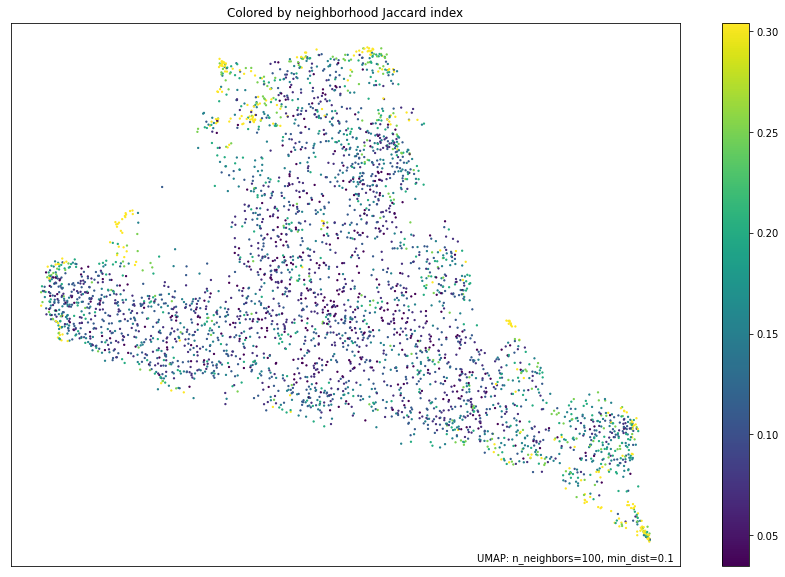

In [18]:
fig, ax = plt.subplots(figsize=(15,10))
umap.plot.diagnostic(genre_map, diagnostic_type='neighborhood', ax=ax)

In [19]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score
data_sample = latent_space.genres[latent_space.latent_cols]
results=[]
kmeans_predictions = []
gmm_predictions = []
for k in range(2,127):
    kmeans = MiniBatchKMeans(n_clusters=k).fit(data_sample)
    predict = kmeans.predict(data_sample)
    result = {
        'k':k,
        'inertia': kmeans.inertia_,
        'silhouette': silhouette_score(data_sample, predict),
    }
    results.append(result)
    kmeans_predictions.append(predict)
    print(result, end='\r')
cluster_results = pd.DataFrame(results)


In [20]:
clusters = 10

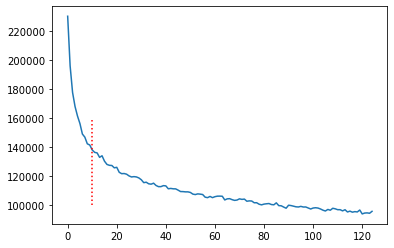

In [21]:
fig, ax = plt.subplots()
cluster_results.inertia.plot(ax=ax)
ax.vlines(x=clusters, ymin=100000, ymax=160000, colors='red', linestyles='dotted')

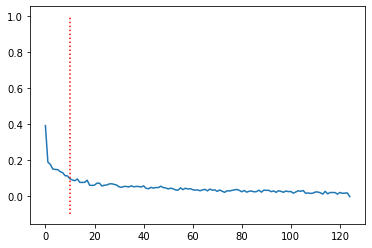

In [22]:
fig, ax = plt.subplots()

cluster_results.silhouette.plot()
ax.vlines(x=clusters, ymin=-.1, ymax=1, colors='red', linestyles='dotted')

In [23]:
genre_projected = latent_space.genres[latent_space.latent_cols].astype('float32')
kmeans_genre = MiniBatchKMeans(n_clusters=clusters).fit(genre_projected)
p = umap.plot.interactive(genre_map, labels = kmeans_genre.predict(genre_projected), point_size=10, hover_data=genre_hover_data)
umap.plot.show(p)

<IPython.core.display.Javascript object>


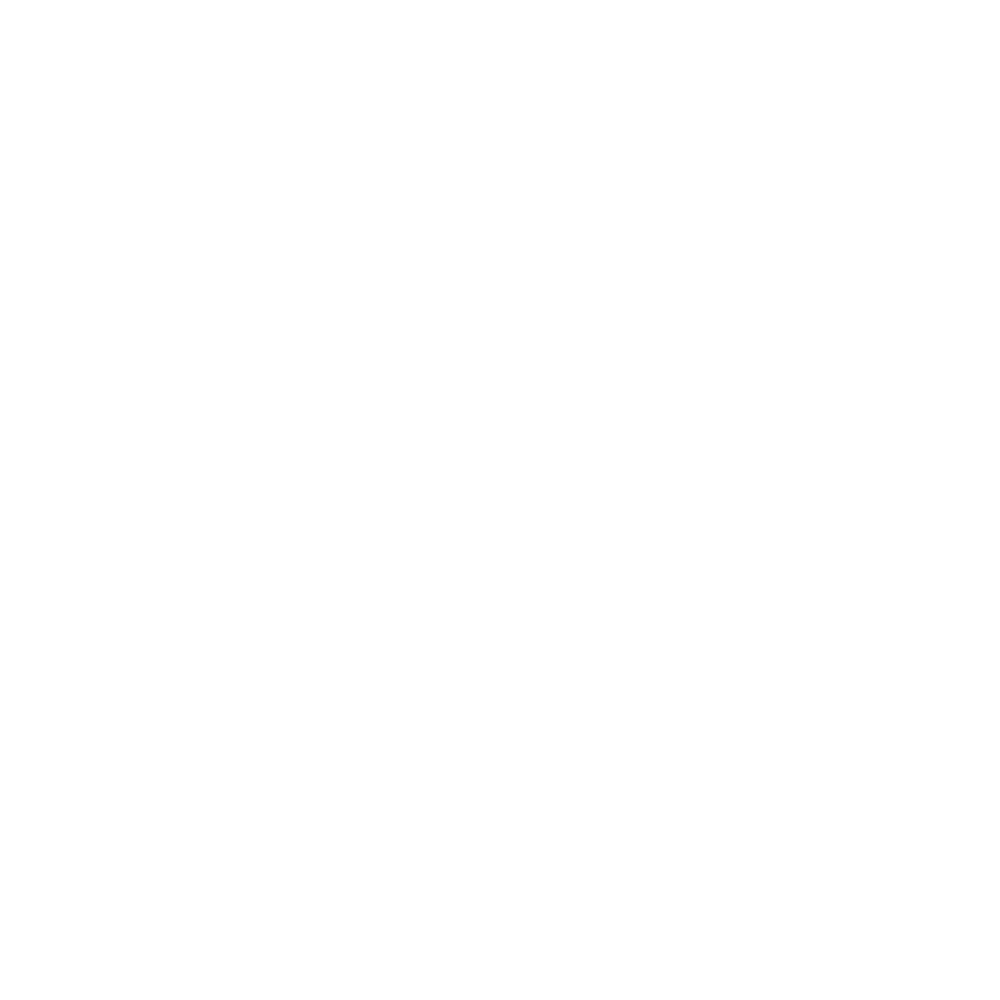

/var/folders/jy/34vkbxz97tbgm78bc07fmx380000gn/T/ipykernel_13187/2489030196.py:6: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


In [31]:
%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D

genre_map_3d = umap.UMAP(n_components=3, n_neighbors=100, min_dist=.1).fit_transform(latent_space.genres[latent_space.latent_cols])
fig = plt.figure(figsize=(10,10))
ax = Axes3D(fig)

ax.scatter(*genre_map_3d.T, c=kmeans_genre.predict(genre_projected), cmap='Spectral')

In [25]:
artists = latent_space.artists.copy().reset_index()
artist_genres = latent_space.tracks[['artist_name', 'artist_genres']].drop_duplicates(subset=['artist_name'])
artists = artists.merge(right=artist_genres, how='left', on='artist_name')
artist_latents = artists[latent_space.latent_cols]
artist_mapper = umap.UMAP(n_neighbors=60, min_dist=.5).fit(artist_latents)
artist_hover_data = artists[['artist_name','artist_genres']]
p = umap.plot.interactive(artist_mapper, labels=kmeans_genre.predict(artist_latents[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=artist_hover_data)
p.legend
umap.plot.show(p)

In [26]:
tracks_sample = latent_space.tracks.copy().sample(50000, random_state=42).reset_index()
mapper = umap.UMAP(n_neighbors=50, min_dist=.1).fit(tracks_sample[latent_space.latent_cols])

In [27]:
hover_data = tracks_sample[['artist_name','track_name','artist_genres']]
umap.plot.output_notebook()
p = umap.plot.interactive(mapper, labels=kmeans_genre.predict(tracks_sample[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=hover_data)
umap.plot.show(p)

Loading BokehJS ...

In [28]:
time_latents = tracks_sample[latent_space.latent_cols[:128]]
time_mapper = umap.UMAP(n_neighbors=50, min_dist=.1).fit(time_latents)
p = umap.plot.interactive(time_mapper, labels=kmeans_genre.predict(tracks_sample[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=hover_data)
umap.plot.show(p)

In [29]:
freq_latents = tracks_sample[latent_space.latent_cols[128:]]
freq_mapper = umap.UMAP(n_neighbors=50, min_dist=.1).fit(freq_latents)
p = umap.plot.interactive(freq_mapper, labels=kmeans_genre.predict(tracks_sample[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=hover_data)
umap.plot.show(p)

<IPython.core.display.Javascript object>


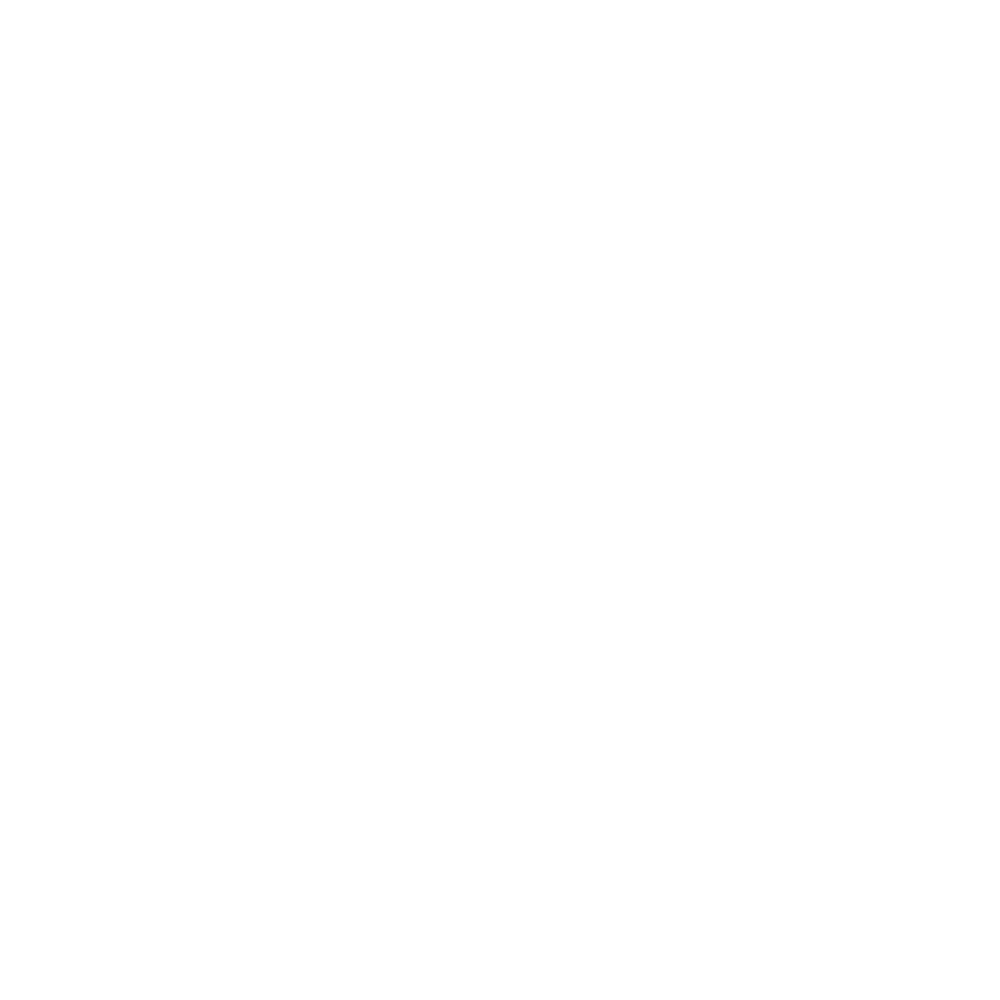

In [30]:
fig, ax = plt.subplots(1, figsize=(10, 10))
plt.scatter(*embedding.T, s=0.3, alpha=.2, c=kmeans_genre.predict(data), cmap='Spectral')

In [43]:
latent_space.get_index_by_artist_name('Michael Jackson')

,track_id,track_name,artist_name
19234,46eu3SBuFCXWsPT39Yg3tJ,Don't Stop 'Til You Get Enough,Michael Jackson
56545,0sKlV58cODrjxGFOyf9IXY,The Way You Make Me Feel - 2012 Remaster,Michael Jackson
174712,5lWFrW5T3JtxVCLDb7etPu,Bad - 2012 Remaster,Michael Jackson
219055,5ChkMS8OtdzJeqyybCc9R5,Billie Jean,Michael Jackson
233292,2bCQHF9gdG5BNDVuEIEnNk,Smooth Criminal - 2012 Remaster,Michael Jackson


In [44]:
latent_space.get_similar_tracks_by_index(174712)

,index,track_name,artist_name,track_uri,similarity
0,174712,Bad - 2012 Remaster,Michael Jackson,spotify:track:5lWFrW5T3JtxVCLDb7etPu,1.000000
1,20745,Pushin' Me Out,D-side,spotify:track:12RIX03rdmMy3rqhgCTzcE,0.761474
2,7578,The Grind,Rick Garcia,spotify:track:2jHN5XbAxsN9m7Wd2ZS6wE,0.742145
3,130865,Drama in the Subway,à;Grumh...,spotify:track:7faIiUHEpWAAqz2rWp9t7Z,0.738266
4,118714,Drunken Sailor,Captain Tractor,spotify:track:5AYAIh8WUMKlypRFL5dNQI,0.732885
5,224452,Here I Am,Demo,spotify:track:0ct4apEtZXIwi1pP6PJBMG,0.723524
6,87395,Do You Know - Infiniti (Scott Christina) Remix,Infiniti (Scott Christina),spotify:track:452G65yeZRcTCvc5yojbGV,0.721091
7,70048,Arrival,Husman,spotify:track:5AOlLWl9KE6MRpTCqUprNd,0.719441
8,43059,Dance With Me (Remix) - Original Mix,Heaven 7,spotify:track:4eTyiLZ6Ak7gbi3AmZqyBx,0.717591
9,187823,Minds I - Retrodub Remix,Merka,spotify:track:445PcA4AqyveWDDJfQpr3i,0.717113
